<a href="https://colab.research.google.com/github/AnkitRajSri/SentimentPredictor/blob/main/SentimentAnalysisUsingTensorflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Fri Jan 22 21:26:57 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
!pip install --upgrade tensorflow-gpu==2.2.0
!pip uninstall tensorflow-datasets
!pip install tensorflow-datasets==4.0.0

     |████████████████████████████████| 516.2MB 33kB/s 
     |████████████████████████████████| 3.0MB 30kB/s 
     |████████████████████████████████| 460kB 59.9MB/s 
  Using cached https://files.pythonhosted.org/packages/d6/84/759f5dd23fec8ba71952d97bcc7e2c9d7d63bdc582421f3cd4be845f0c98/gast-0.3.3-py2.py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/60/06/cafdd44889200e5438b897388f3075b52a8ef01f28a17366d91de0fa2d05/h5py-2.10.0-cp36-cp36m-manylinux1_x86_64.whl
ERROR: fancyimpute 0.4.3 requires tensorflow, which is not installed.
ERROR: tf-nightly 2.5.0.dev20210122 has requirement gast==0.4.0, but you'll have gast 0.3.3 which is incompatible.
ERROR: tf-nightly 2.5.0.dev20210122 has requirement h5py~=3.1.0, but you'll have h5py 2.10.0 which is incompatible.
  Found existing installation: tensorflow-estimator 2.4.0
    Uninstalling tensorflow-estimator-2.4.0:
      Successfully uninstalled tensorflow-estimator-2.4.0
  Found existing installation: gast 0.4.0
    Unins

In [3]:
from __future__ import absolute_import, division, print_function, unicode_literals

try:
  !pip uninstall tb-nightly tensorboardX tensorboard
  !pip install tf-nightly
except Exception:
  pass

Uninstalling tb-nightly-2.5.0a20210122:
  Would remove:
    /usr/local/bin/tensorboard
    /usr/local/lib/python3.6/dist-packages/tb_nightly-2.5.0a20210122.dist-info/*
    /usr/local/lib/python3.6/dist-packages/tensorboard/*
  Would not remove (might be manually added):
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/__init__.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/beholder.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/beholder_plugin.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/beholder_plugin_loader.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/colormaps.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/file_system_tools.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/im_util.py
    /usr/local/lib/python3.6/dist-packages/tensorboard/plugins/beholder/resources/arrays-missing.png
    /usr/l

In [4]:
import tensorflow as tf

import os
import datetime
import tensorflow_datasets as tfds

%load_ext tensorboard

In [5]:
import pkg_resources

for entry_point in pkg_resources.iter_entry_points("tensorboard_plugins"):
  print(entry_point.dist)

tensorboard-plugin-wit 1.7.0
tb-nightly 2.5.0a20210122


In [6]:
!rm -r /usr/local/lib/python3.6/dist-packages/tensorboardcolab-0.0.22.dist-info/

rm: cannot remove '/usr/local/lib/python3.6/dist-packages/tensorboardcolab-0.0.22.dist-info/': No such file or directory


In [7]:
print(tf.__version__)

2.2.0


In [8]:
tf.config.experimental.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU'),
 PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [9]:
dataset, info = tfds.load("amazon_us_reviews/Mobile_Electronics_v1_00", with_info=True)
train_dataset = dataset["train"]

Shuffling and writing examples to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0.incompleteCSOB16/amazon_us_reviews-train.tfrecord


Dataset amazon_us_reviews downloaded and prepared to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0. Subsequent calls will reuse this data.


In [10]:
info

tfds.core.DatasetInfo(
    name='amazon_us_reviews',
    version=0.1.0,
    description='Amazon Customer Reviews (a.k.a. Product Reviews) is one of Amazons iconic products. In a period of over two decades since the first review in 1995, millions of Amazon customers have contributed over a hundred million reviews to express opinions and describe their experiences regarding products on the Amazon.com website. This makes Amazon Customer Reviews a rich source of information for academic researchers in the fields of Natural Language Processing (NLP), Information Retrieval (IR), and Machine Learning (ML), amongst others. Accordingly, we are releasing this data to further research in multiple disciplines related to understanding customer product experiences. Specifically, this dataset was constructed to represent a sample of customer evaluations and opinions, variation in the perception of a product across geographical regions, and promotional intent or bias in reviews.

Over 130+ million cus

In [11]:
print(train_dataset)

<PrefetchDataset shapes: {data: {customer_id: (), helpful_votes: (), marketplace: (), product_category: (), product_id: (), product_parent: (), product_title: (), review_body: (), review_date: (), review_headline: (), review_id: (), star_rating: (), total_votes: (), verified_purchase: (), vine: ()}}, types: {data: {customer_id: tf.string, helpful_votes: tf.int32, marketplace: tf.string, product_category: tf.string, product_id: tf.string, product_parent: tf.string, product_title: tf.string, review_body: tf.string, review_date: tf.string, review_headline: tf.string, review_id: tf.string, star_rating: tf.int32, total_votes: tf.int32, verified_purchase: tf.int64, vine: tf.int64}}>


In [12]:
len(list(train_dataset))

104975

In [13]:
BUFFER_SIZE = 30000
BATCH_SIZE = 128

In [14]:
train_dataset = train_dataset.shuffle(BUFFER_SIZE, reshuffle_each_iteration=False)

In [15]:
for reviews in train_dataset.take(2):
  print(reviews)

{'data': {'customer_id': <tf.Tensor: shape=(), dtype=string, numpy=b'16653239'>, 'helpful_votes': <tf.Tensor: shape=(), dtype=int32, numpy=2>, 'marketplace': <tf.Tensor: shape=(), dtype=string, numpy=b'US'>, 'product_category': <tf.Tensor: shape=(), dtype=string, numpy=b'Mobile_Electronics'>, 'product_id': <tf.Tensor: shape=(), dtype=string, numpy=b'B000OD5F1M'>, 'product_parent': <tf.Tensor: shape=(), dtype=string, numpy=b'891429186'>, 'product_title': <tf.Tensor: shape=(), dtype=string, numpy=b'Boss DB-30 Dr. Beat Digital Metronome'>, 'review_body': <tf.Tensor: shape=(), dtype=string, numpy=b"I went to my local GC to check out tuners & saw this one but thought I could find a better rice online & I did. I have Boss effects pedals now & have had many Boss products through the years & they have never let me down so the brand name was certainly a selling point. That being said they have not let me down in the quality department & so far I really like this metronome. I was also looking fo

In [19]:
for reviews in train_dataset.take(10):
  review_text = reviews["data"]
  print(review_text.get("review_body").numpy())
  print(review_text.get("star_rating").numpy())
  print(tf.where(review_text.get("star_rating")>3, 1, 0).numpy())

b"I went to my local GC to check out tuners & saw this one but thought I could find a better rice online & I did. I have Boss effects pedals now & have had many Boss products through the years & they have never let me down so the brand name was certainly a selling point. That being said they have not let me down in the quality department & so far I really like this metronome. I was also looking for a compoact unit to carry in my gig bag. One feature I wanted was to be able to choose my own beats per minute which this unit has & not have 'pre-set' ones & the tap feature is really cool to figure out song tempos on the fly. There are a few other rhythmic functions/settings as well that I have not really used so far but I would imagine would be usfeul to drummers, percussionists, & musicians in general. Judging by the quality I think I will be using it for years to come."
4
1
b'Product is excellent, however, if I had ordered it directly through the merchant instead of going through Amazon,

In [25]:
tokenizer = tfds.deprecated.text.Tokenizer()

vocabulary_set = set()
for _, reviews in train_dataset.enumerate():
  review_text = reviews["data"]
  review_tokens = tokenizer.tokenize(review_text.get("review_body").numpy())
  vocabulary_set.update(review_tokens)

In [26]:
vocab_size = len(vocabulary_set)
vocab_size

73738

In [27]:
encoder = tfds.deprecated.text.TokenTextEncoder(vocabulary_set)

In [28]:
print(vocabulary_set)

{'indispensable', 'a170', 'disturbance', 'wordy', 'confuses', 'mo1UE8EERIWPEJH', 'midlands', 'conectas', 'Rockies', 'signaled', 'Lumina', 'DS65', 'Quick', 'adhesed', 'coiling', 'SURPRISED', '1974', 'Classpad', 'RMS', 'transcoder', 'aptx', 'meind', '6X6', 'Touchpad', 'boominess', 'Ergo', 'cirle', 'LOVING', 'devaient', 'DEALER', 'Headband', 'compartment', 'pilas', 'esperado', 'stirring', 'allen', '1200x1', 'Fiance', 'dicator', 'Downsides', 'bpm', 'outclass', 'wore', 'unpluging', 'BlackBerrys', 'funcionando', 'BOOM', '6yr', 'conceive', 'gads', 'Comuter', 'ANT', 'gutted', 'woofer', '1975', 'Vikuiti', 'swab', 'fixe', 'rewriting', 'Graphics', 'georgeous', 'DiskStation', 'yoy', 'TechStream', 'Logic', 'messy', 'novo02', '22am', 'Wears', 'QUIERO', 'Tunestrap', 'Finely', 'longboarding', 'E40', 'LA144', 'ATIS', 'woodshop', 'ashes', 'répondu', 'pitched', 'Vidoes', 'tackier', 'clicked', 'receivable', 'dac', 'blv', 'Wilco', 'Audiovx', 'B000CEE2PS', 'croaks', 'amfm', 'Tv', 'Omaha', '500g', 'COMO', '0

In [29]:
for reviews in train_dataset.take(5):
  review_text = reviews["data"]
  print(review_text.get("review_body").numpy())
  encoded_example = encoder.encode(review_text.get("review_body").numpy())
  print(encoded_example)

b"I went to my local GC to check out tuners & saw this one but thought I could find a better rice online & I did. I have Boss effects pedals now & have had many Boss products through the years & they have never let me down so the brand name was certainly a selling point. That being said they have not let me down in the quality department & so far I really like this metronome. I was also looking for a compoact unit to carry in my gig bag. One feature I wanted was to be able to choose my own beats per minute which this unit has & not have 'pre-set' ones & the tap feature is really cool to figure out song tempos on the fly. There are a few other rhythmic functions/settings as well that I have not really used so far but I would imagine would be usfeul to drummers, percussionists, & musicians in general. Judging by the quality I think I will be using it for years to come."
[20118, 23573, 17921, 70392, 51744, 56040, 17921, 34906, 20841, 54773, 40643, 43070, 5818, 71622, 57246, 20118, 14810, 

In [30]:
for index in encoded_example:
  print("{} ----> {}".format(index, encoder.decode([index])))

20045 ----> Trying
17921 ----> to
67351 ----> find
8999 ----> a
69677 ----> case
53034 ----> for
70392 ----> my
56847 ----> Ariaz
43070 ----> this
28871 ----> was
44343 ----> the
3134 ----> only
5818 ----> one
7560 ----> This
69677 ----> case
69471 ----> has
20390 ----> plenty
968 ----> of
63825 ----> protection
53034 ----> for
67818 ----> your
18770 ----> player


In [31]:
def encode(text_tensor, label_tensor):
  encoded_text = encoder.encode(text_tensor.numpy())
  label = tf.where(label_tensor>3, 1, 0)
  return encoded_text, label

In [32]:
def encode_map_fn(tensor):
  text = tensor["data"].get("review_body")
  label = tensor["data"].get("star_rating")

  encoded_text, label = tf.py_function(encode,
                                       inp=[text, label],
                                       Tout=(tf.int64, tf.int32))
  encoded_text.set_shape([None])
  label.set_shape([])

  return encoded_text, label

In [33]:
ar_encoded_data = train_dataset.map(encode_map_fn)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Index'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Index'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Index'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [35]:
for f0, f1 in ar_encoded_data.take(2):
  print(f0)
  print(f1)

tf.Tensor(
[20118 23573 17921 70392 51744 56040 17921 34906 20841 54773 40643 43070
  5818 71622 57246 20118 14810 67351  8999  8985 21150 21664 20118 62446
 20118 15903 72447 39756 26576  3565 15903 43160 64605 72447 46149 71548
 44343 11053 23693 15903 28865 11576 33275 13366  5909 44343 11167 18167
 28871 29434  8999 19535 31096 36299   172 71079 23693 15903  6440 11576
 33275 13366 71386 44343 57224 44208  5909 50689 20118 55707 34356 43070
 67806 20118 28871 38104 15148 53034  8999  9236 71665 17921  6103 71386
 70392 11367 39865  2985 18018 20118 55140 28871 17921 63057  4975 17921
 22168 70392  6150 50437 54318 69540 22378 43070 71665 69471  6440 15903
 69920 51027 32042 44343 29108 18018 48363 55707 22498 17921 50546 20841
 35524 44468 25207 44343 15051  3217  6142  8999 70343  6459  9420  5661
 67586 15531 66296 17223 20118 15903  6440 55707  7456  5909 50689 71622
 20118 68517 56517 68517 63057 47040 17921  3113 18743 60816 71386   718
 33951 25403 44343 57224 20118 43778 201

In [38]:
TAKE_SIZE = 10000

train_data = ar_encoded_data.skip(TAKE_SIZE).shuffle(BUFFER_SIZE)
train_data = train_data.padded_batch(BATCH_SIZE)

test_data = ar_encoded_data.take(TAKE_SIZE)
test_data = test_data.padded_batch(BATCH_SIZE)

In [37]:
vocab_size += 1

In [39]:
sample_text, sample_labels = next(iter(test_data))
sample_text[0], sample_labels[0]

(<tf.Tensor: shape=(964,), dtype=int64, numpy=
 array([20118, 23573, 17921, 70392, 51744, 56040, 17921, 34906, 20841,
        54773, 40643, 43070,  5818, 71622, 57246, 20118, 14810, 67351,
         8999,  8985, 21150, 21664, 20118, 62446, 20118, 15903, 72447,
        39756, 26576,  3565, 15903, 43160, 64605, 72447, 46149, 71548,
        44343, 11053, 23693, 15903, 28865, 11576, 33275, 13366,  5909,
        44343, 11167, 18167, 28871, 29434,  8999, 19535, 31096, 36299,
          172, 71079, 23693, 15903,  6440, 11576, 33275, 13366, 71386,
        44343, 57224, 44208,  5909, 50689, 20118, 55707, 34356, 43070,
        67806, 20118, 28871, 38104, 15148, 53034,  8999,  9236, 71665,
        17921,  6103, 71386, 70392, 11367, 39865,  2985, 18018, 20118,
        55140, 28871, 17921, 63057,  4975, 17921, 22168, 70392,  6150,
        50437, 54318, 69540, 22378, 43070, 71665, 69471,  6440, 15903,
        69920, 51027, 32042, 44343, 29108, 18018, 48363, 55707, 22498,
        17921, 50546, 20841, 3

In [40]:
for f0, f1 in test_data.take(10):
  print(tf.unique_with_counts(f1)[2].numpy())

[87 41]
[88 40]
[79 49]
[75 53]
[35 93]
[85 43]
[85 43]
[85 43]
[89 39]
[74 54]


In [41]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(vocab_size, 128))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences=True)))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64)))

for units in [64, 64]:
  model.add(tf.keras.layers.Dense(units, activation="relu"))

model.add(tf.keras.layers.Dense(1))

In [42]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 128)         9438592   
_________________________________________________________________
bidirectional (Bidirectional (None, None, 256)         263168    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 128)               164352    
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 9,878,593
Trainable params: 9,878,593
Non-trainable params: 0
______________________________________________

In [43]:
!rm -r /tmp/logs/

rm: cannot remove '/tmp/logs/': No such file or directory


In [46]:
log_dir = os.path.join("/tmp/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir, histogram_freq=1)
check_pointer = tf.keras.callbacks.ModelCheckpoint(filepath="/tmp/sentiment_analysis.hdf5", verbose=1, save_best_only=True)

model.compile(optimizer="adam",
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=["accuracy"])

In [47]:
history = model.fit(train_data, epochs=4, validation_data=test_data, callbacks=[tensorboard_callback, check_pointer])

Epoch 1/4
742/742 [==============================] - ETA: 0s - loss: 0.3434 - accuracy: 0.8441
Epoch 00001: val_loss improved from inf to 0.31292, saving model to /tmp/sentiment_analysis.hdf5
742/742 [==============================] - 276s 372ms/step - loss: 0.3434 - accuracy: 0.8441 - val_loss: 0.3129 - val_accuracy: 0.8661
Epoch 2/4
742/742 [==============================] - ETA: 0s - loss: 0.2369 - accuracy: 0.9026
Epoch 00002: val_loss improved from 0.31292 to 0.31088, saving model to /tmp/sentiment_analysis.hdf5
742/742 [==============================] - 273s 368ms/step - loss: 0.2369 - accuracy: 0.9026 - val_loss: 0.3109 - val_accuracy: 0.8743
Epoch 3/4
742/742 [==============================] - ETA: 0s - loss: 0.1895 - accuracy: 0.9236
Epoch 00003: val_loss improved from 0.31088 to 0.29184, saving model to /tmp/sentiment_analysis.hdf5
742/742 [==============================] - 272s 366ms/step - loss: 0.1895 - accuracy: 0.9236 - val_loss: 0.2918 - val_accuracy: 0.8740
Epoch 4/4
7

In [49]:
model.save("/tmp/final_sentiment_analysis.hdf5")

In [50]:
!ls -alrt /tmp/*.hdf5

-rw-r--r-- 1 root root 118630448 Jan 22 22:38 /tmp/sentiment_analysis.hdf5
-rw-r--r-- 1 root root 118630448 Jan 22 22:44 /tmp/final_sentiment_analysis.hdf5


In [51]:
eval_loss, eval_acc = model.evaluate(test_data)
print("\nEval loss: {:.3f}, Eval Accuracy: {:.3f}".format(eval_loss, eval_acc))

79/79 [==============================] - 15s 189ms/step - loss: 0.3125 - accuracy: 0.8818

Eval loss: 0.313, Eval Accuracy: 0.882


In [52]:
for f0, f1 in test_data.take(1):
  print(f1)
  print(model.predict(f0))

tf.Tensor(
[1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1
 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0
 1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0
 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1], shape=(128,), dtype=int32)
[[ 0.09080037]
 [ 0.7124637 ]
 [-1.3408446 ]
 [ 3.9840035 ]
 [-1.0086075 ]
 [-2.7160823 ]
 [ 5.4849386 ]
 [ 0.24005571]
 [ 5.541208  ]
 [ 5.5893693 ]
 [ 4.9095783 ]
 [ 6.9185243 ]
 [-0.71034807]
 [-3.1718254 ]
 [ 4.5950274 ]
 [ 2.0063715 ]
 [ 0.97018355]
 [ 0.8500146 ]
 [ 3.5506818 ]
 [ 1.2908887 ]
 [ 5.5330257 ]
 [ 3.5861564 ]
 [ 4.558956  ]
 [ 5.2091446 ]
 [ 5.46874   ]
 [-4.3493295 ]
 [ 3.087697  ]
 [ 5.9048433 ]
 [ 4.3606586 ]
 [ 5.297651  ]
 [ 5.365644  ]
 [ 2.1174827 ]
 [ 0.4399083 ]
 [-3.9364598 ]
 [ 4.852117  ]
 [ 4.4931393 ]
 [ 5.0929193 ]
 [-2.423924  ]
 [ 6.294484  ]
 [-2.1898117 ]
 [-3.0953624 ]
 [ 5.56018   ]
 [-0.6570668 ]
 [ 5.097054  ]
 [-0.4605269 ]
 [ 5.5395355 ]
 [-1.23623

In [53]:
model.layers

In [54]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 128)         9438592   
_________________________________________________________________
bidirectional (Bidirectional (None, None, 256)         263168    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 128)               164352    
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 9,878,593
Trainable params: 9,878,593
Non-trainable params: 0
______________________________________________

In [55]:
model.get_layer("embedding").output

<tf.Tensor 'embedding/Identity:0' shape=(None, None, 128) dtype=float32>

In [56]:
!nvidia-smi

Fri Jan 22 22:49:46 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   77C    P0    35W /  70W |   8851MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [57]:
history.history["accuracy"]

[0.8441168665885925,
 0.9026165008544922,
 0.9236430525779724,
 0.9211897850036621]

In [60]:
list(range(1, len(history.history["accuracy"])+1))

[1, 2, 3, 4]

In [62]:
import matplotlib.pyplot as plt

def plot_graphs(history, metric):
  plt.plot(history.history[metric])
  plt.plot(history.history["val_"+metric])
  plt.xlabel("epochs")
  plt.ylabel(metric)
  plt.legend([metric, "val_"+metric])
  plt.show()

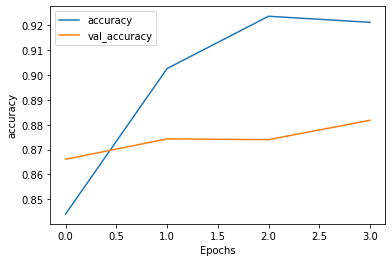

In [63]:
plot_graphs(history, "accuracy")

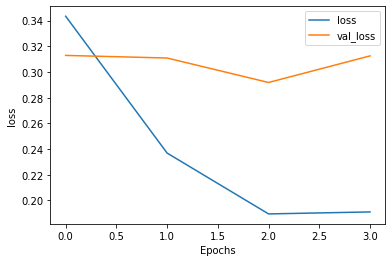

In [64]:
plot_graphs(history, "loss")

In [68]:
tf.keras.backend.clear_session()

In [72]:
# sa_load = tf.keras.models.load_model("/tmp/final_sentiment_analysis.hdf5", compile=False)

In [73]:
def pad_to_size(vec, size):
  zeros = [0] * (size - len(vec))
  vec.extend(zeros)
  return vec

In [74]:
def predict_fn(pred_text):
  encoded_pred_text = encoder.encode(pred_text)
  print(encoded_pred_text)
  encoded_pred_text = pad_to_size(encoded_pred_text, 32)
  print(encoded_pred_text)
  encoded_pred_text = tf.cast(encoded_pred_text, tf.float32)
  predictions = model.predict(tf.expand_dims(encoded_pred_text, 0))
  return predictions

In [78]:
pred_text = ("This watch is pretty bad. Color and dial look pathetic")
predictions = predict_fn(pred_text)
print(predictions)

[7560, 60287, 48363, 36074, 31646, 61398, 64609, 60907, 62490, 25945]
[7560, 60287, 48363, 36074, 31646, 61398, 64609, 60907, 62490, 25945, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[-0.33216652]]


In [79]:
pred_text = ("Color and dial does not look as advertised. Shipping was not any better as well.")
predictions = predict_fn(pred_text)
print(predictions)

[61398, 64609, 60907, 68832, 6440, 62490, 15531, 67552, 50151, 28871, 6440, 13944, 8985, 15531, 66296]
[61398, 64609, 60907, 68832, 6440, 62490, 15531, 67552, 50151, 28871, 6440, 13944, 8985, 15531, 66296, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[-0.33745903]]


In [80]:
pred_text = ("Amazing product. Fast delivery. Nice packaging.")
predictions = predict_fn(pred_text)
print(predictions)

[4603, 31529, 43019, 12068, 70672, 51492]
[4603, 31529, 43019, 12068, 70672, 51492, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[6.4227757]]


In [81]:
pred_text = ("Nice product. Packing could have been better.")
predictions = predict_fn(pred_text)
print(predictions)

[70672, 31529, 69696, 14810, 15903, 60039, 8985]
[70672, 31529, 69696, 14810, 15903, 60039, 8985, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[3.1227312]]


In [82]:
print(tf.distribute.get_strategy())

In [83]:
%reload_ext tensorboard

In [84]:
%tensorboard --logdir /tmp/logs

<IPython.core.display.Javascript object>

In [85]:
encoder.save_to_file("/tmp/sa_encoder.vocab")

In [86]:
model.save("/content/drive/MyDrive/Sentiment_Analysis/sentiment_analysis.hdf5")

In [87]:
encoder.save_to_file("/content/drive/MyDrive/Sentiment_Analysis/sa_encoder.vocab")